In [1]:
import pandas as pd
import gensim
import tensorflow as tf
from keras_preprocessing import image as im
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns
import os
import tensorflow_text as text
from tqdm import tqdm
sns.set()

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


# Loading the data

### images and annotations loading 

In [2]:
!ls ../data/imdb

annotations_1.csv  annotations_mal.csv	 Dima_Mal_0  Vova_0
annotations_2.csv  annotations_olek.csv  Dima_Tar_0
annotations.csv    annotations_Tar2.csv  Oleksii_0


In [3]:
ABS_PATH = "../data/imdb/"

In [4]:
annotations = [i for i in os.listdir(ABS_PATH) if i.endswith('csv')]
folders = [i for i in os.listdir(ABS_PATH) if not i.endswith('csv')]

In [5]:
df = pd.DataFrame()
for path in annotations:
    df = pd.concat([df, pd.read_csv(os.path.join(ABS_PATH,path))], axis=0)

In [6]:
df = df.drop_duplicates('image_name').drop(columns='Unnamed: 0').dropna(how='any')

In [7]:
df

,image_name,annotation
0,nm0002102_rm1875874816_1943-5-31_2007.jpg,The woman is distracted by somebody
1,nm0004801_rm671533824_1967-12-1_2013.jpg,Man aggressively holding other man
2,nm1927701_rm2586875904_1992-10-9_2006.jpg,Kid wishing a good luck
3,nm0000702_rm2563217664_1976-3-22_2003.jpg,The woman is surprised by a phone call
4,nm0001701_rm1201459968_1978-9-7_2010.jpg,Man and woman distracted by somebody
...,...,...
977,nm0000301_rm85775872_1982-3-11_1991.jpg,"A woman looks wise and serious, she tries to e..."
978,nm3595501_rm2091026176_1994-3-1_2010.jpg,"Man thinks he looks cool, but the glasses he w..."
979,nm0001101_rm1604893696_1947-12-29_2000.jpg,Policemen and a case officer are discussing on...
980,nm0001401_rm2754582528_1975-6-4_2008.jpg,"A woman looks serious, decisive and aggressive..."


In [8]:
for folder in folders:
    path = os.path.join(ABS_PATH, folder)
    in_folder = os.listdir(path)
    df.loc[df['image_name'].isin(in_folder), 'image_name'] = \
    df.loc[df['image_name'].isin(in_folder), 'image_name'].apply(lambda x: os.path.join(path,x))
    

In [9]:
df = df[df['image_name'].apply(lambda x: 'data' in x.split('/'))]

In [10]:
images = []
for image_name in df['image_name'].values:
    images.append(np.array(im.load_img(image_name, target_size=(224,224))))
images = np.array(images)

In [11]:
images.shape

(1615, 224, 224, 3)

The woman is distracted by somebody


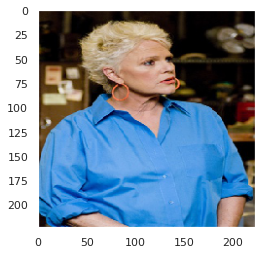

In [12]:
plt.imshow(images[0])
plt.grid(False)
print(df['annotation'].values[0])

# Useful functions

In [13]:
from sklearn.decomposition import PCA
import tensorflow_hub as hub
import tensorflow.keras.applications as apps

In [35]:
# import SentimentIntensityAnalyzer class 
import nltk
from nltk.tokenize import word_tokenize, RegexpTokenizer
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer 
  
# function to print sentiments 
# of the sentence. 
def sentiment_scores(sentence): 
    sid_obj = SentimentIntensityAnalyzer() 
    compounds = dict([(i,sid_obj.polarity_scores(i)['compound']) for i in sentence.split(' ') if sid_obj.polarity_scores(i)['compound']!=0])
    compound_score = sid_obj.polarity_scores(sentence)['compound']
    if compound_score >= 0.05 : 
        sentiment = "Positive"
  
    elif compound_score <= - 0.05 : 
        sentiment = "Negative" 
  
    else : 
        sentiment =  "Neutral" 
    return sentiment, compounds

In [68]:
def sentiment_plot(sizes, labels, cluster_num):
    plt.figure(figsize=(14,12))
    explode = {3 : (0.1,0,0),
    2 : (0.1,0),
    1 : (0)}
    plt.pie(sizes, labels=labels, explode=explode[len(labels)],startangle=90,
           autopct='%1.1f%%')
    plt.title('Number of annotations referred to each sentiment for cluster {}'.format(cluster_num));

In [37]:
def show_features_image(model, image):
    plt.imshow(image)
    extractor = tf.keras.Model(model.layers[0].input, model.layers[-2].output)
    feature_maps = extractor(np.expand_dims(image,axis=0))
    square = 8
    ix = 1
    plt.figure(figsize=(15,12))
    for _ in range(square):
        for _ in range(square):
            ax = plt.subplot(square, square, ix)
            ax.set_xticks([])
            ax.set_yticks([])
            plt.imshow(feature_maps[0, :, :, ix-1], cmap='magma')
            ix += 1
    plt.show() 

In [38]:
def create_representation_images(model, images, use_pca=False):
    features = []
    for image in tqdm(images):
        features.append(np.hstack(model(tf.convert_to_tensor(np.expand_dims(image, axis=0))).numpy()))
    features = np.array(features)
    if use_pca:
        features = PCA(n_components=128).fit_transform(features)

    return features

In [39]:
def show_cluster_images(images, labels, n_labels=3, n_images=5):
    unique_labels = np.random.choice(list(set(labels)),size=n_labels,replace=False)
    rows = len(unique_labels)
    fig, axes = plt.subplots(rows, n_images, figsize=(20,20))
    for c1, label in enumerate(unique_labels):
        idx = np.hstack(np.where(labels==label))
        tmp_images = images[idx]
        to_show = tmp_images[np.random.choice(range(len(tmp_images)), size=n_images,replace=False)]
        for c2, image in enumerate(to_show):
            axes[c1][c2].imshow(image)
            axes[c1][c2].set_ylabel(label)
            axes[c1][c2].grid(False)
            axes[c1][c2].set_yticklabels([])
            axes[c1][c2].set_xticklabels([])


In [40]:
def show_cluster_annotations(annotations, images, labels, n_labels=3, n_annotations=5):
    unique_labels = np.random.choice(list(set(labels)),n_labels,replace=False)
    for label in unique_labels:
        idx  = np.hstack(np.where(labels==label))
        tmp_annotations = np.random.choice(annotations[idx], n_annotations,replace=False)
        sentiments = []
        for annotation in df[df['cluster_annotations']==label]['annotation'].values:
            sentiments.append(sentiment_scores(annotation))
        sentiment, words_compound = zip(*sentiments)
        sent_labels, sizes = zip(*count_unique(sentiment))
        sentiment_plot(sizes, sent_labels, label)
        for annotation in tmp_annotations:
            tmp_idx = np.hstack(np.where(annotations==annotation))
            plt.figure() 
            plt.imshow(images[tmp_idx][0])
            plt.title('Annotations for label {} :'.format(label))
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])
            plt.xlabel(annotation)
        


In [41]:
def make_inertia_plot(data,number=20):
    inertia_list = []
    list_clusters = []
    for i in range(3,number+1):
        kmeans = KMeans(n_clusters=i).fit(data)
        inertia_list.append(kmeans.inertia_)
        list_clusters.append(i)
    plt.figure(figsize=(12,8))
    plt.title('Elbow method')
    plt.scatter(list_clusters,inertia_list,s=50, color='r')
    plt.plot(list_clusters,inertia_list)
    plt.xticks(range(1,number+1))

In [42]:
def create_representation_annotations_hub(annotations, hub_link, use_pca=False):
    model = hub.load(hub_link)
    features = []
    for annotation in tqdm(annotations):
        features.append(np.hstack(model(tf.convert_to_tensor(np.expand_dims(annotation,axis=0))).numpy()))
    features = np.array(features)
    if use_pca:
        features = PCA(n_components=128).fit_transform(features)
    return features

In [46]:
def text_clustering(annotations_features,images, n_clusters=9):
    kmeans_text = KMeans(n_clusters=n_clusters, max_iter=1000, random_state=0)
    kmeans_text = kmeans_text.fit(annotations_features)
    predictions_text = kmeans_text.predict(annotations_features)
    unique_annotations_labels, annotations_labels_counts = np.unique(predictions_text, return_counts=True)
    unique_annotations_labels, annotations_labels_counts = zip(*sorted(list(zip(unique_annotations_labels,annotations_labels_counts)), key=lambda x: x[1]))
    df['cluster_annotations'] = predictions_text
    show_cluster_annotations(annotations, images, predictions_text)
    plt.figure(figsize=(10,8))
    plt.bar(range(len(unique_annotations_labels)), annotations_labels_counts)
    plt.xticks(range(len(unique_annotations_labels)), unique_annotations_labels);

In [47]:
def image_clustering(image_features, n_clusters=9):
    kmeans = KMeans(n_clusters=n_clusters, max_iter=1000, random_state=0)
    kmeans = kmeans.fit(image_features)
    predictions_images = kmeans.predict(image_features)
    unique_image_labels, image_labels_counts = np.unique(predictions_images, return_counts=True)
    unique_image_labels, image_labels_counts = zip(*sorted(list(zip(unique_image_labels,image_labels_counts)), key=lambda x: x[1]))
    plt.figure(figsize=(10,8))
    plt.bar(range(len(unique_image_labels)), image_labels_counts)
    plt.xticks(range(len(unique_image_labels)), unique_image_labels);
    show_cluster_images(images, predictions_images, n_labels=5, n_images=5)
    df['cluster_images'] = predictions_images

In [49]:
def count_unique(annotations):
    tokens, counts = np.unique(np.hstack([i.split(' ') for i in annotations]), return_counts=True)
    count_tuple = sorted(list(zip(tokens, counts)),key= lambda x: x[1])[::-1]
    return count_tuple

# Processing

In [24]:
images = images/255
annotations = df['annotation'].str.lower().values

# Experiments


## Experiment 1: pretrained resnet classification feature vector + pretrained NNLM + KNN 

### pretrained resnet conv4_block5_out features

In [25]:
resnet = apps.ResNet152V2(include_top=False, weights='imagenet')


In [26]:
outputs = [i for i in resnet.layers if i.name=='conv4_block5_out'][0]
inputs = resnet.layers[0]
pooling = tf.keras.layers.GlobalAveragePooling2D()(outputs.output)
resnet = tf.keras.Model(inputs.input,pooling)

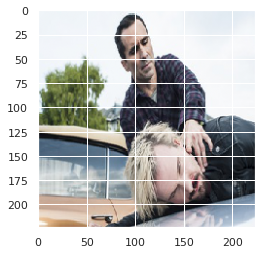

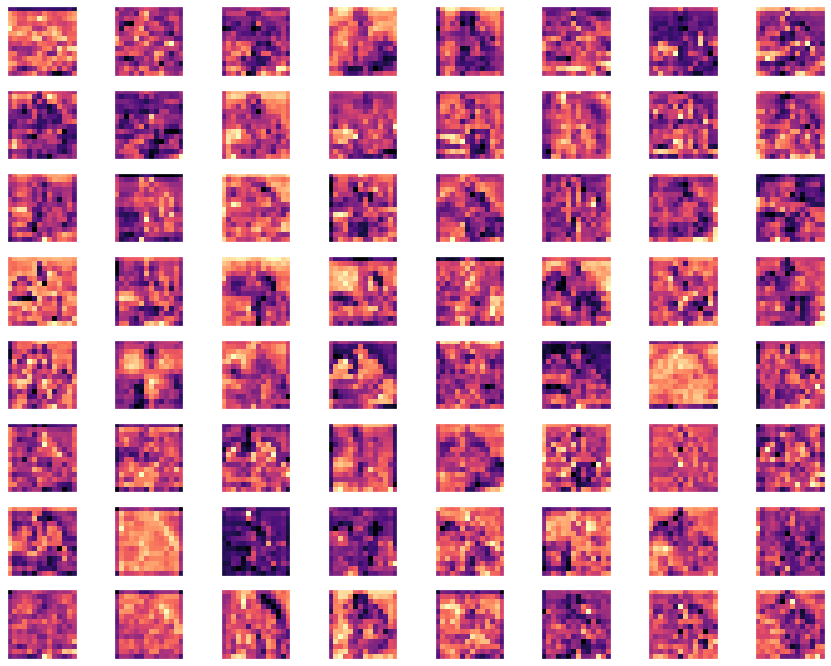

In [27]:
show_features_image(resnet, images[1])

In [28]:
image_features = create_representation_images(resnet, images,
                                                 use_pca=False)

100%|██████████| 1615/1615 [02:32<00:00, 10.57it/s]


### pretrained NNLM features

In [29]:
annotations_features = create_representation_annotations_hub(annotations, hub_link="https://tfhub.dev/google/nnlm-en-dim128/2",
                                                            use_pca=False)

100%|██████████| 1615/1615 [00:00<00:00, 2423.93it/s]


### KNN on resnet features and NNLM features

### resnet

In [30]:
from sklearn.cluster import KMeans

Exception ignored in: <function CapturableResourceDeleter.__del__ at 0x7f5222930050>
Traceback (most recent call last):
  File "/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/tensorflow/python/training/tracking/tracking.py", line 208, in __del__
    self._destroy_resource()
  File "/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/tensorflow/python/eager/def_function.py", line 828, in __call__
    result = self._call(*args, **kwds)
  File "/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/tensorflow/python/eager/def_function.py", line 871, in _call
    self._initialize(args, kwds, add_initializers_to=initializers)
  File "/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/tensorflow/python/eager/def_function.py", line 726, in _initialize
    *args, **kwds))
  File "/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packag

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


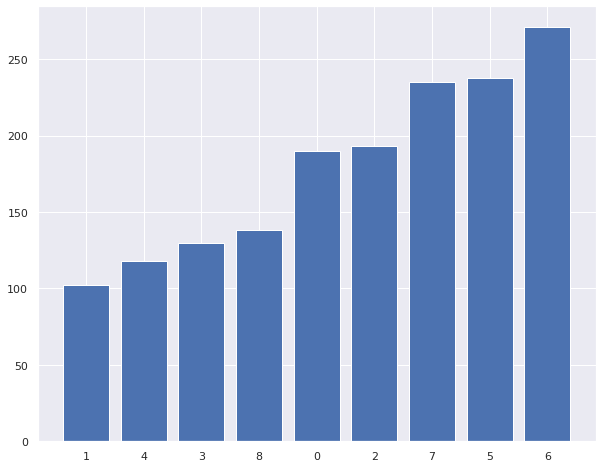

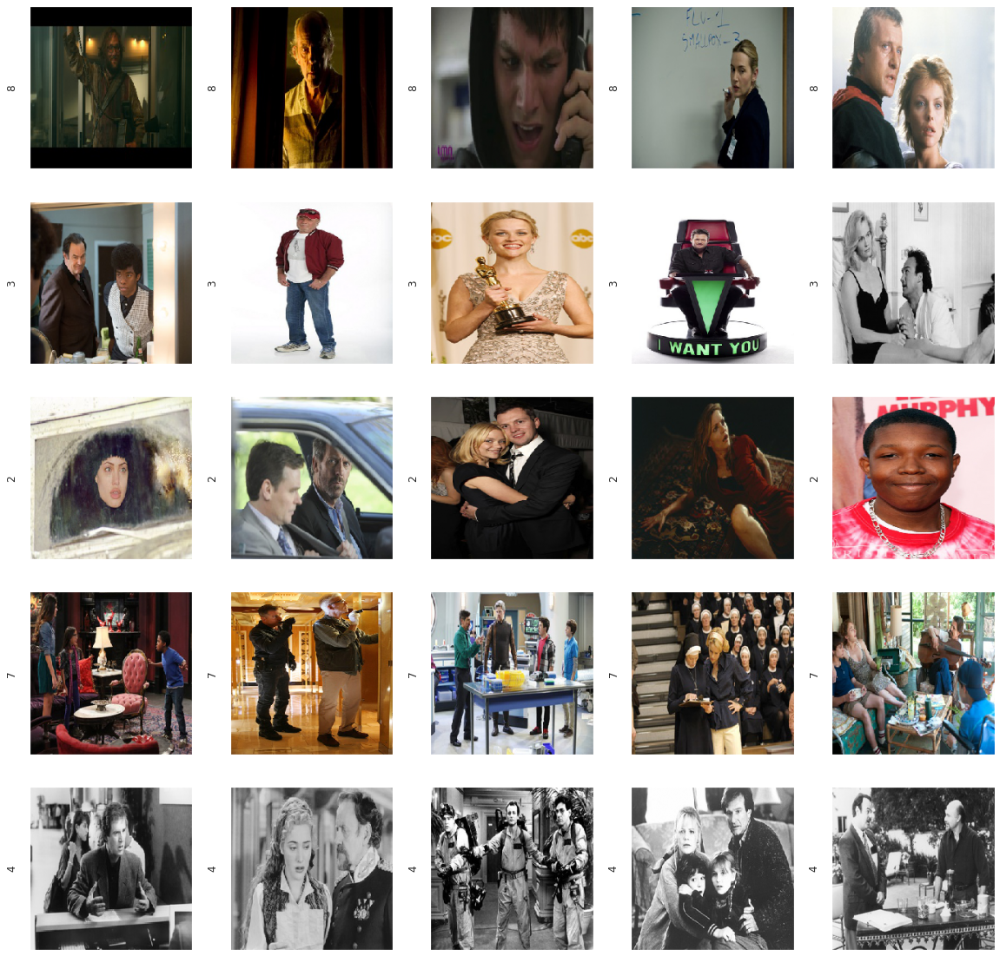

In [31]:
image_clustering(image_features)

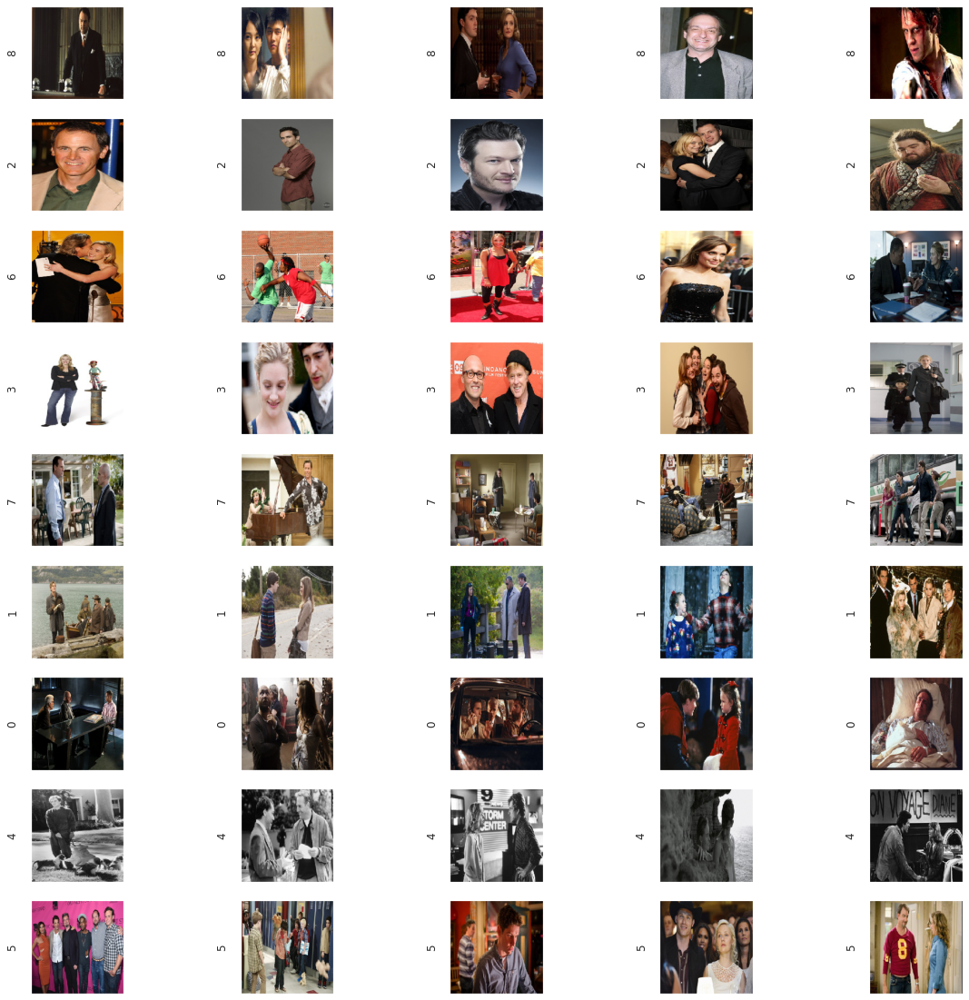

In [32]:
show_cluster_images(images, df['cluster_images'], n_labels=9, n_images=5)


### NNLM

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


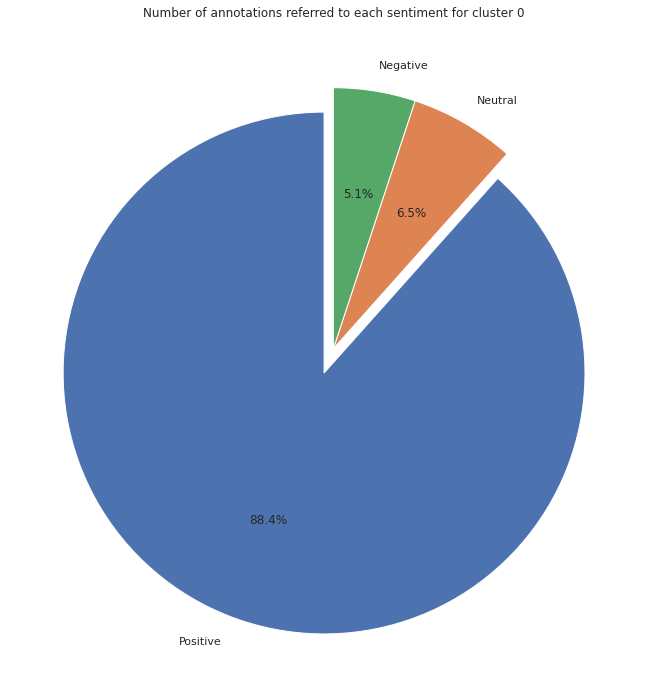

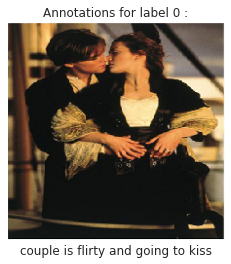

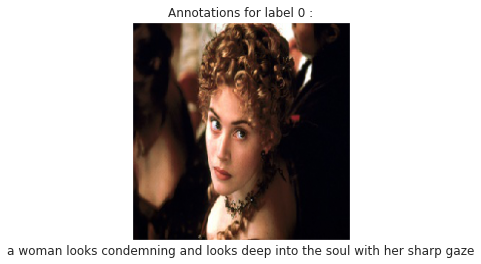

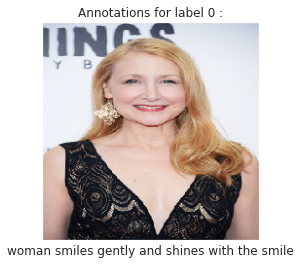

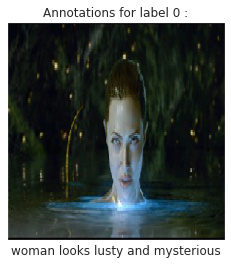

...

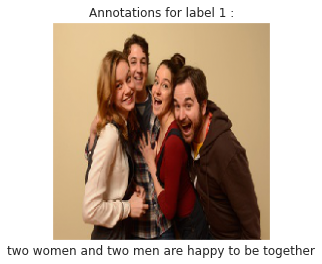

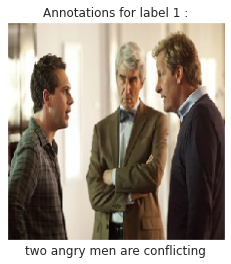

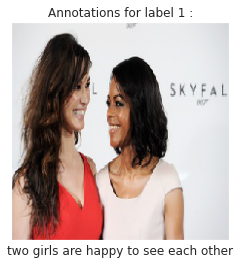

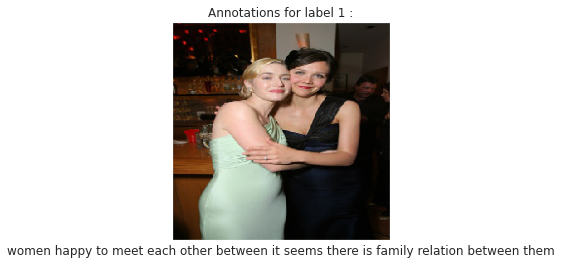

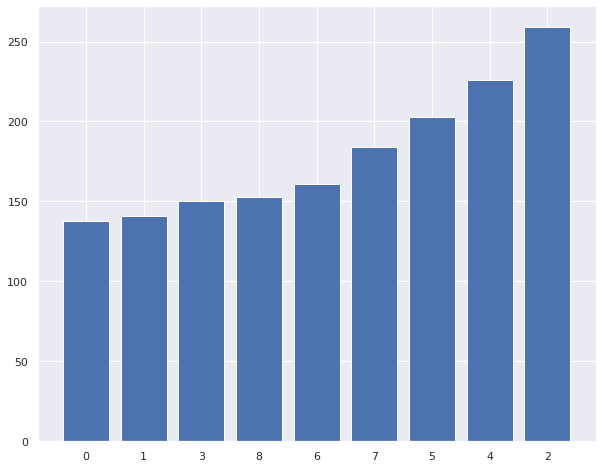

In [50]:
text_clustering(annotations_features,images)

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


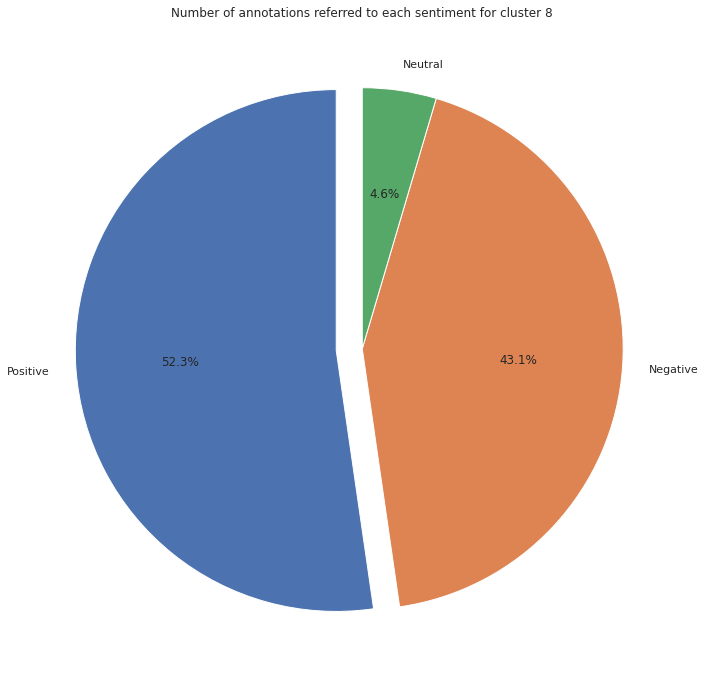

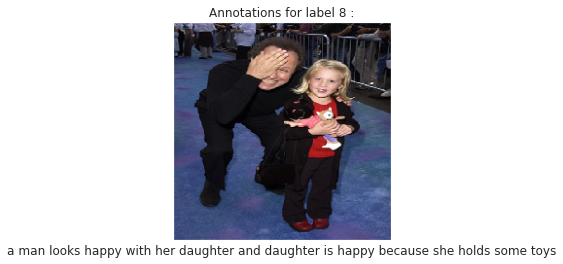

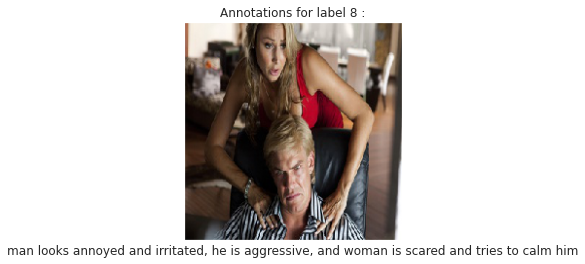

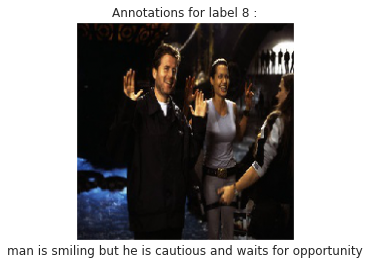

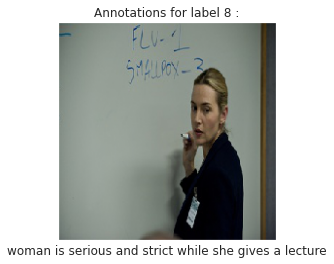

...

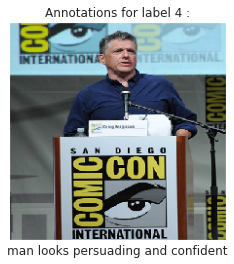

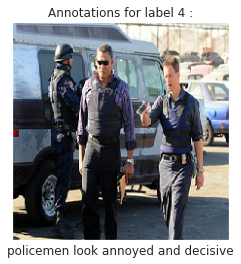

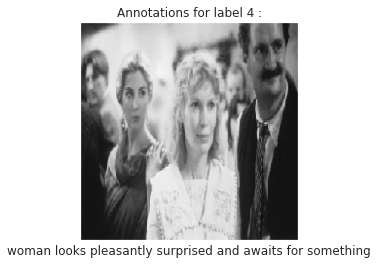

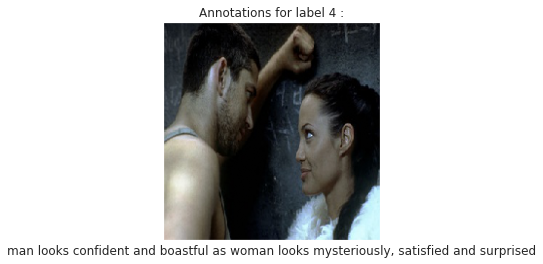

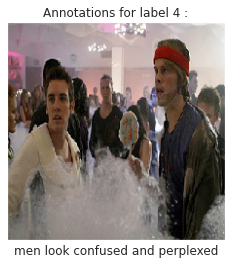

In [51]:
show_cluster_annotations(annotations,images, df['cluster_annotations'], 9, 10)

In [52]:
from collections import Counter

In [53]:
sorted(Counter(np.hstack(df[df['cluster_annotations']==1].annotation.apply(lambda x: x.split()).values)).items(),
       key=lambda x: x[1])[::-1][:25]

[('are', 111),
 ('Two', 66),
 ('other', 46),
 ('men', 45),
 ('each', 44),
 ('to', 34),
 ('happy', 31),
 ('and', 30),
 ('a', 30),
 ('women', 21),
 ('having', 19),
 ('of', 18),
 ('conversation', 17),
 ('couple', 16),
 ('Three', 16),
 ('they', 14),
 ('enjoying', 14),
 ('is', 13),
 ('the', 13),
 ('together', 12),
 ('in', 11),
 ('A', 10),
 ('about', 10),
 ('with', 10),
 ('Couple', 9)]

In [54]:
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import normalized_mutual_info_score

In [55]:
def custom_metric(a, b):
    metric = []
    for cluster in df[a].unique():
        tmp = df[df[a]==cluster]
        N1 = len(tmp.values)
        N2 = max(tmp[b].value_counts())
        if N1>=N2:
            metric.append(N2/N1)
        else:
            metric.append(N1/N2)
    return np.mean(metric)

In [56]:
def metrics():
    intersection_score = (custom_metric('cluster_annotations', 'cluster_images')+custom_metric('cluster_images','cluster_annotations'))/2
    ari = adjusted_rand_score(df['cluster_annotations'].values, df['cluster_images'].values)
    nmi = normalized_mutual_info_score(df['cluster_annotations'].values, df['cluster_images'].values)
    print('Intersection score : {}%'.format(intersection_score*100))
    print('ARI score : {}%'.format(ari*100))
    print('NMI score : {}%'.format(nmi*100))

In [57]:
metrics()

Intersection score : 20.997887339060846%
ARI score : 1.7558170329090614%
NMI score : 4.207957846220026%


# Experiment 2 resnet + bert

### bert

In [58]:
def make_bert_features(annotations, use_pca=False):
    text_input = tf.keras.layers.Input(shape=(), dtype=tf.string)
    preprocessor = hub.KerasLayer(
        "https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
    encoder_inputs = preprocessor(text_input)
    encoder = hub.KerasLayer(
        "https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4",
        trainable=True)
    outputs = encoder(encoder_inputs)
    pooled_output = outputs["pooled_output"]     
    sequence_output = outputs["sequence_output"] 
    embedding_model = tf.keras.Model(text_input, pooled_output)
    features = []
    for annotation in tqdm(annotations):
        features.append(np.hstack(embedding_model(np.expand_dims(annotation,axis=0)).numpy()))
    features = np.array(features)
    if use_pca:
        features = PCA(n_components=3).fit_transform(features)
    return features

In [59]:
annotations_features = make_bert_features(annotations, False)

  0%|          | 0/1615 [00:00<?, ?it/s]

100%|██████████| 1615/1615 [03:29<00:00,  7.71it/s]


/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


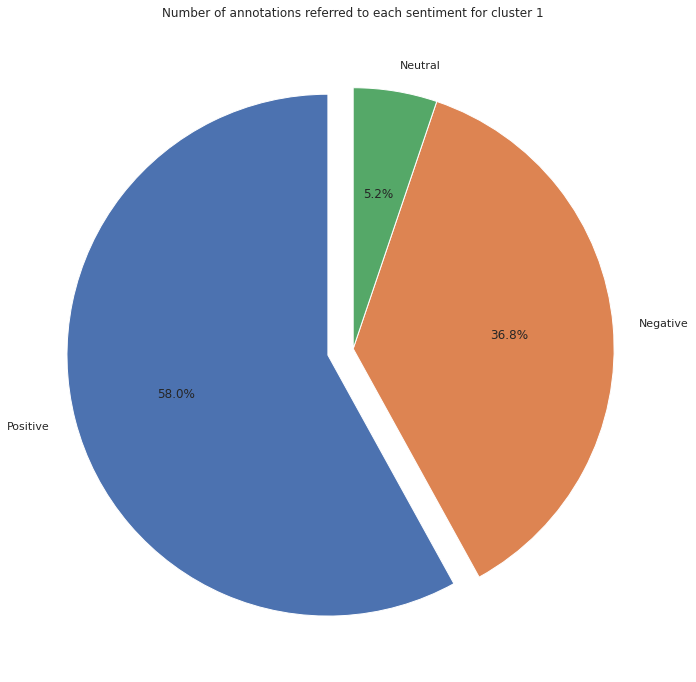

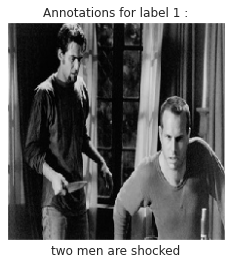

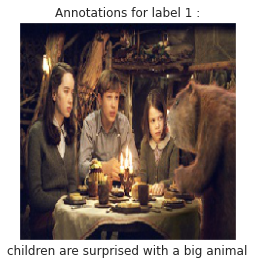

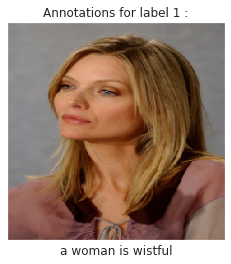

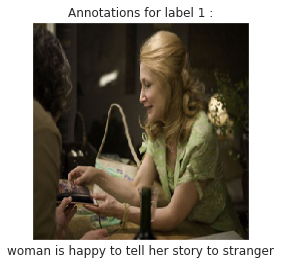

...

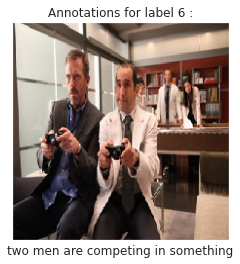

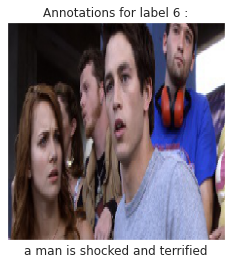

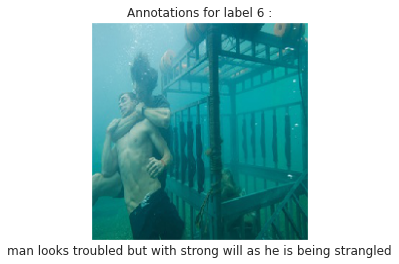

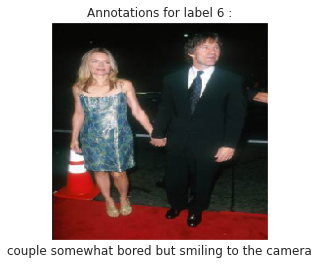

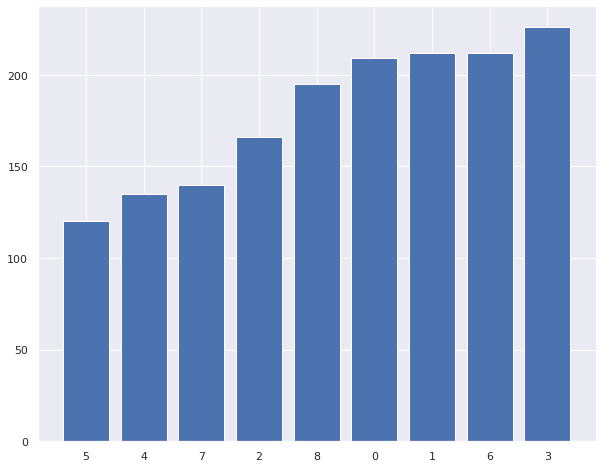

In [61]:
text_clustering(annotations_features, images)

In [62]:
sorted(Counter(np.hstack(df[df['cluster_annotations']==1].annotation.apply(lambda x: x.split()).values)).items(),
       key=lambda x: x[1])[::-1][:10]

[('is', 104),
 ('The', 96),
 ('are', 87),
 ('man', 70),
 ('the', 62),
 ('happy', 59),
 ('to', 43),
 ('a', 41),
 ('woman', 39),
 ('A', 35)]

In [63]:
metrics()

Intersection score : 17.846650447384%
ARI score : 0.1856063175434236%
NMI score : 1.2712736635392536%


## Experiment 3, resnet  feature + bert finetuned for stbs task

In [64]:
from sentence_transformers import SentenceTransformer

In [65]:
embedder = SentenceTransformer('distilbert-base-nli-stsb-mean-tokens')

In [66]:
annotations_features = embedder.encode(annotations)

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


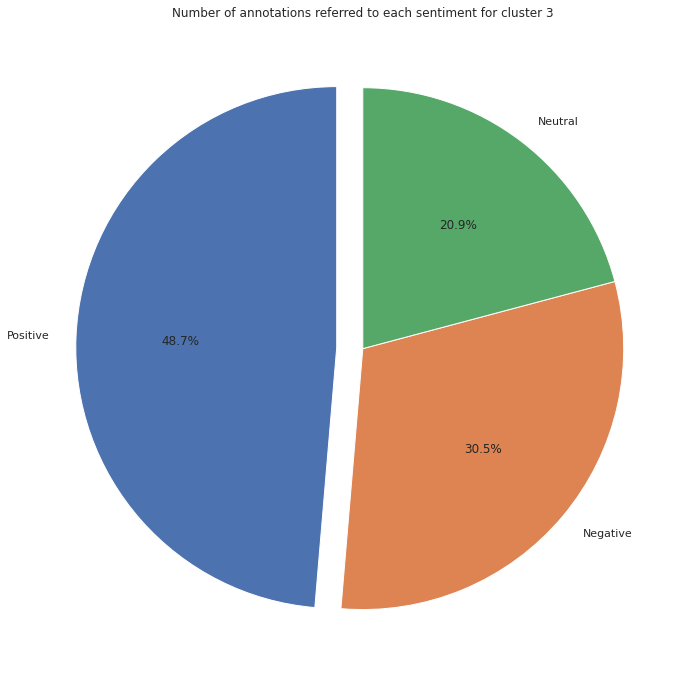

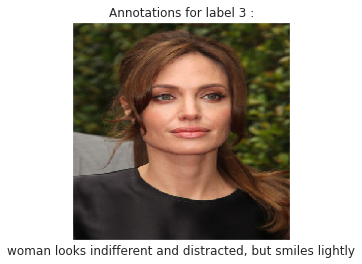

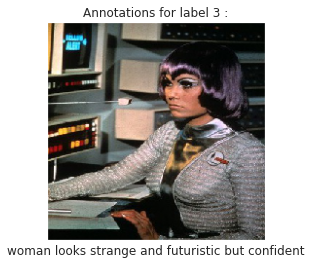

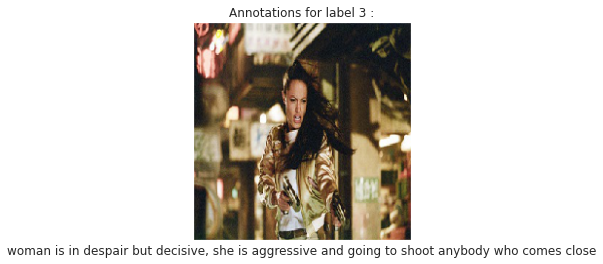

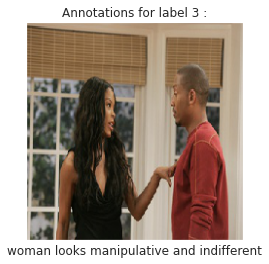

...

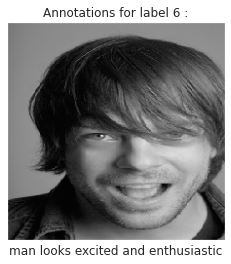

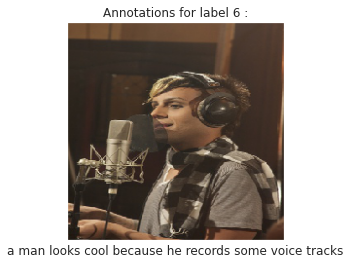

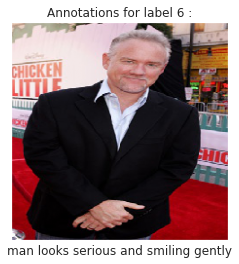

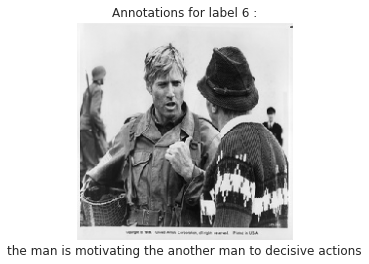

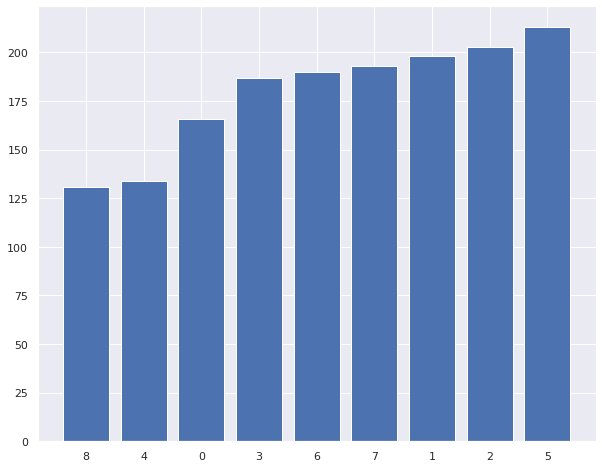

In [69]:
text_clustering(annotations_features,images)

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


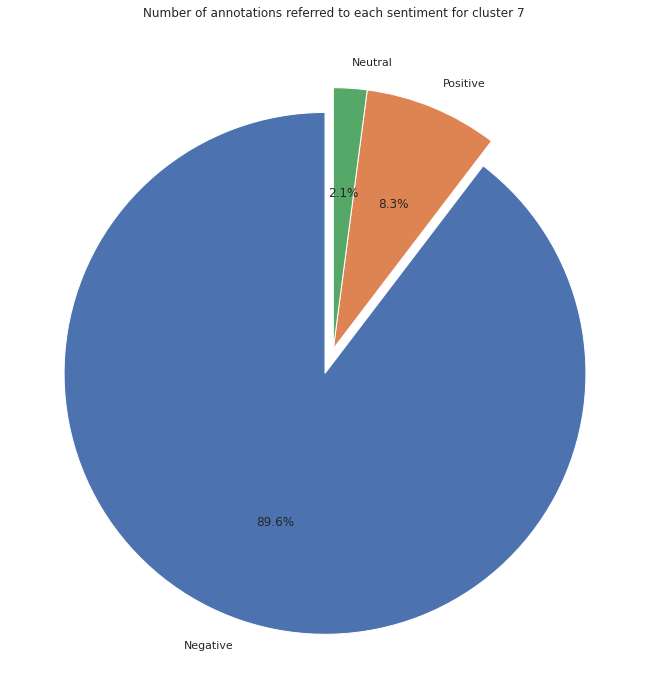

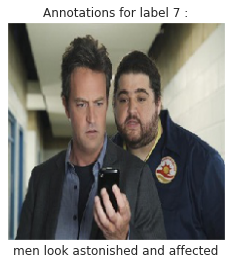

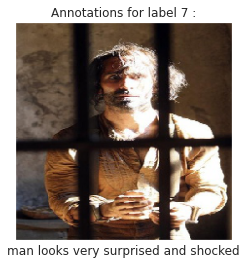

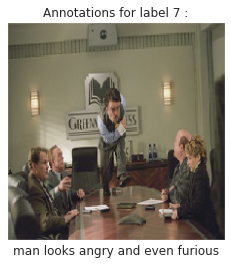

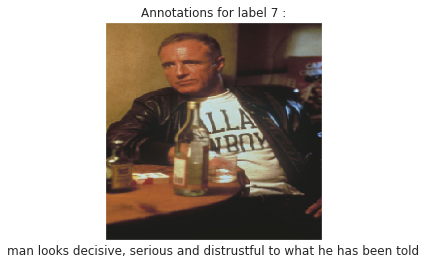

...

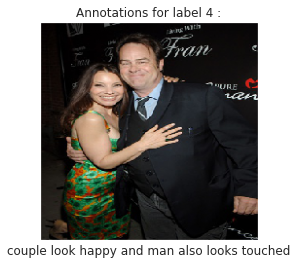

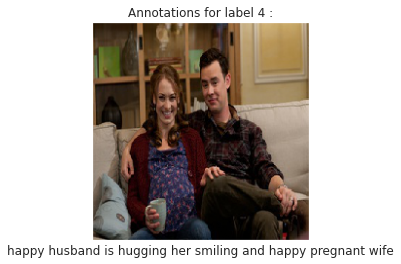

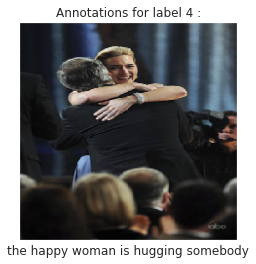

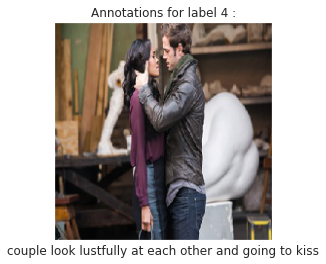

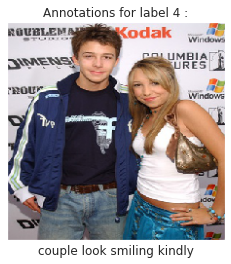

In [70]:
show_cluster_annotations(annotations, images, df['cluster_annotations'], 9, 10)

In [71]:
sorted(Counter(np.hstack(df[df['cluster_annotations']==1].annotation.apply(lambda x: x.split()).values)).items(),
       key=lambda x: x[1])[::-1][:10]

[('and', 117),
 ('is', 74),
 ('looks', 73),
 ('to', 68),
 ('man', 66),
 ('Man', 58),
 ('the', 50),
 ('he', 48),
 ('are', 45),
 ('A', 40)]

In [72]:
metrics()

Intersection score : 20.2970878769982%
ARI score : 1.3787724463593405%
NMI score : 3.3912746504271776%


## Experiment 4, resnet  feature + word2vec

### Preparing w2v

In [73]:
def load_emb_from_disk(path):
    model = gensim.models.KeyedVectors.load_word2vec_format(path, binary=True)

    return model

In [74]:
from nltk.corpus import stopwords 

In [75]:
prepared_annotations_w2v = []
for sentence in annotations:
    sentence = ''.join([i for i in sentence if not (i in [',','.','!','?'] )])
    prepared_annotations_w2v.append([i for i in sentence.split(' ') if not (i in stopwords.words('english'))])

In [76]:
unique_words_annotations = np.unique(np.hstack(prepared_annotations_w2v))

In [77]:
len(unique_words_annotations)

1446

In [78]:
unique_words_annotations

array(['', 'abandoned', 'abnormal', ..., 'yet', 'young', 'youth'],
      dtype='<U16')

In [79]:
w2v_embeddings = load_emb_from_disk('embeddings/GoogleNews-vectors-negative300.bin')

In [80]:
def get_emb_rep(tokens, embeddings):
    dict_tokens = {}
    missing = []
    for w in tqdm(tokens):
        try:
            try:
                dict_tokens.update({w: embeddings.word_vec(w.lower())})
            except:
                dict_tokens.update({w: embeddings.word_vec(w.captialize())})
        except:
            missing.append(w)

    print('{} words where absent in embedding'.format(len(missing)))
    return dict_tokens, missing


In [81]:
w2v_embeddings, missing = get_emb_rep(unique_words_annotations, w2v_embeddings)

  0%|          | 0/1446 [00:00<?, ?it/s]/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `word_vec` (Use get_vector instead).
  import sys
100%|██████████| 1446/1446 [00:00<00:00, 284740.07it/s]

8 words where absent in embedding


In [82]:
with open('missing_in_w2v.txt','w') as f:
    for i in missing:
        f.write(i+'\n')

In [83]:
def create_representation_embeddings(embeddings, sentences, dim=300):
    feature = np.zeros(shape=(len(sentences), dim))
    for n, sentence in enumerate(sentences):
        vector = np.zeros(shape=(dim,))
        counter = 0 
        for word in sentence:
            representation = embeddings.get(word)
            if not(representation is None):
                vector+=representation
                counter+=1
        if counter!=0:
            vector/=counter
        feature[n,:] = vector
    return feature
            

In [84]:
annotations_features = create_representation_embeddings(w2v_embeddings, prepared_annotations_w2v)

In [85]:
from sklearn.metrics.pairwise import cosine_similarity

In [86]:
annotations[1]

'man aggressively holding other man'

In [87]:
annotations[np.argsort(-cosine_similarity(annotations_features[1].reshape(1,-1), annotations_features[1:]))[0][:5]]

array(['the woman is distracted by somebody',
       'three women are interested in some story',
       'the amazed and scared kids are looking on ceiling',
       'the man is showing evidences to the other man',
       'two mans are suprised'], dtype=object)

### experiment

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


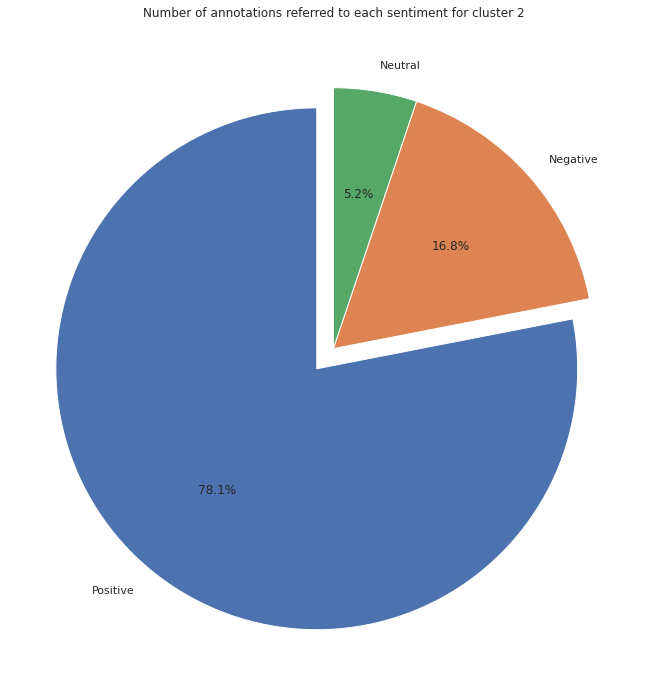

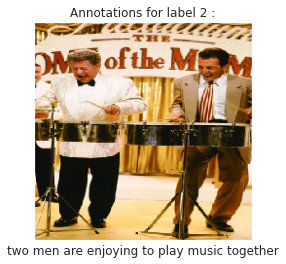

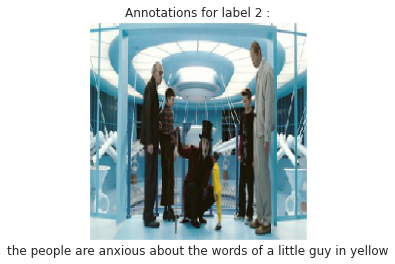

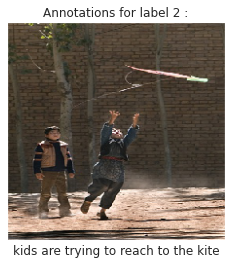

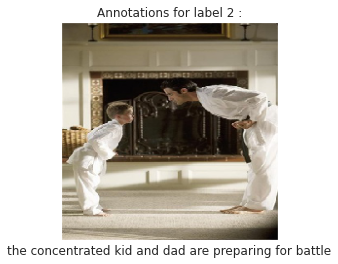

...

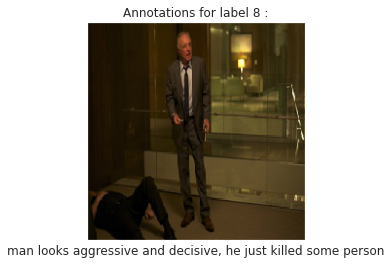

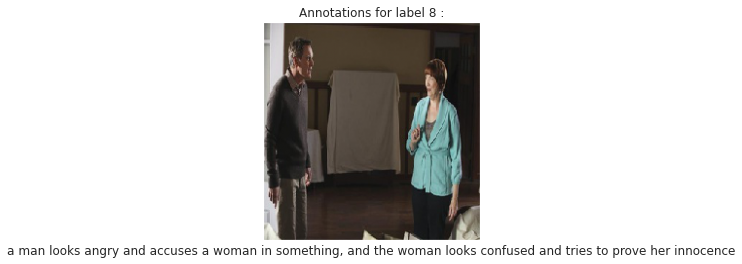

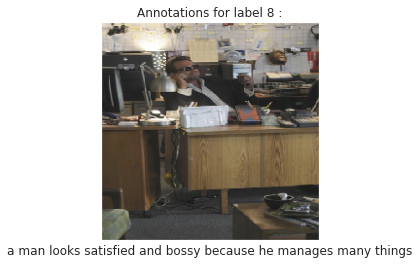

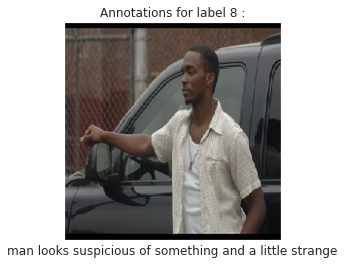

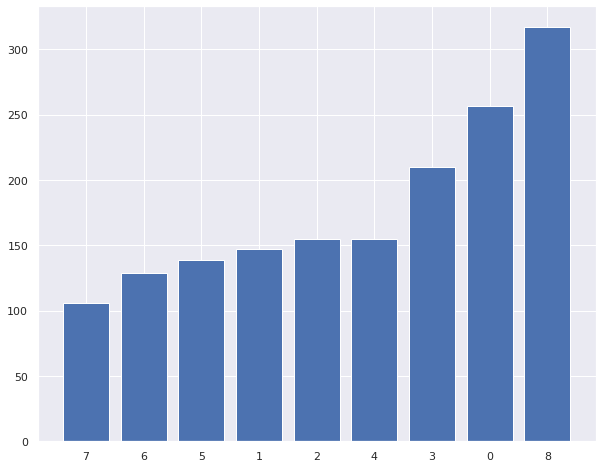

In [88]:
text_clustering(annotations_features, images)

/home/volodymyr/Parallel-emotional-intent-clustering/env/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


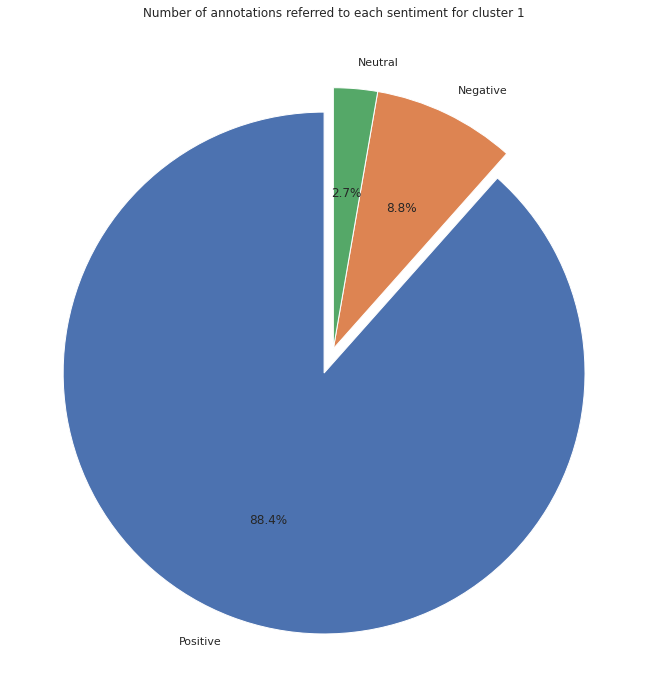

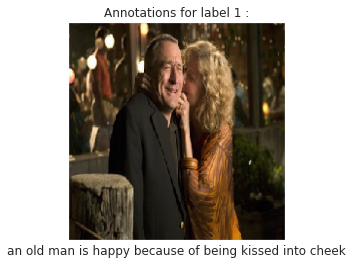

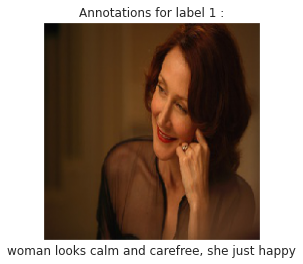

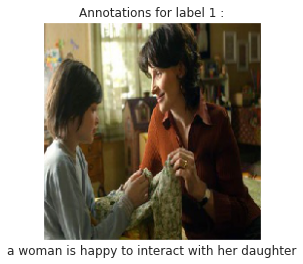

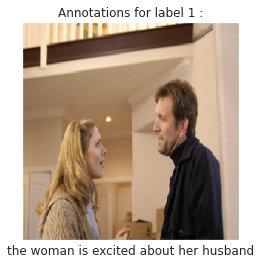

...

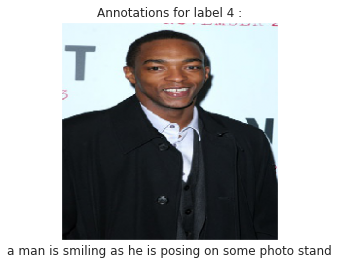

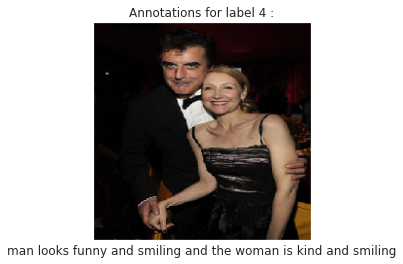

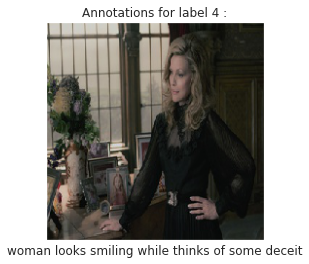

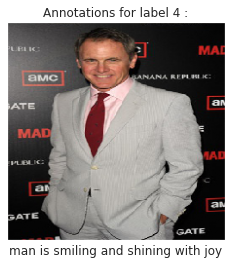

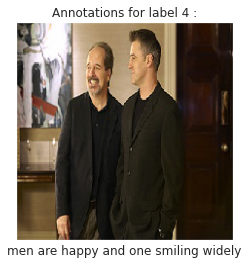

In [92]:
show_cluster_annotations(annotations, images, df['cluster_annotations'], 9, 10)

In [89]:
metrics()

Intersection score : 24.136581803225926%
ARI score : 2.223610260426863%
NMI score : 5.190689980039006%
